Animation size has reached 21367231 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


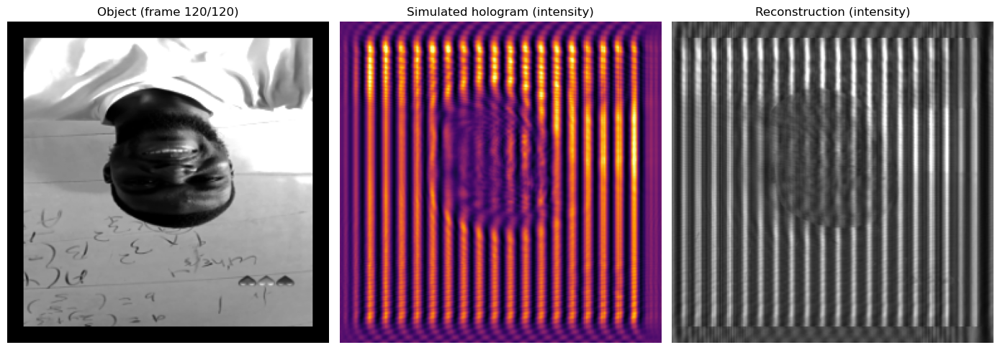

In [1]:
# - Loads a local image (use the path you provided)
# - Animates object translation/rotation/scale + camera z-motion
# - For each frame: Fresnel propagation -> hologram (off-axis) -> reconstruction
# - Displays an interactive three-panel animation (Object | Hologram | Reconstruction)
#
# Paste into a Jupyter notebook cell and run. Uses ani.to_jshtml() so you get play/pause controls.

import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML
from PIL import Image, ImageOps
import os

#CONFIG (tweak these as needed)
image_path = r"C:\Users\HP\Desktop\New folder (3)\Snapchat-1038946133.jpg" # Dear reader, kindly set this path to your local image path
N = 256                   # simulation grid (NxN). 128 for speed, 512 for more detail
physical_size = 5e-3      # meters (extent of object/sensor plane)
wavelength = 633e-9       # meters
z0 = 0.05                 # base propagation distance in meters
frames = 120              # number of animation frames
ref_type = "offaxis"      # "onaxis" or "offaxis"
ref_tilt_deg = 2.0        # degrees for off-axis reference
pad_factor = 1            # padding factor for Fresnel conv method (>=1). Use 1 for speed.
add_noise = False         # set True to add simple noise
noise_sigma = 0.01        # gaussian noise level (fraction of max)
# motion settings (object)
translate_amp = 0.25      # fraction of physical_size for translation amplitude
rotate_amp_deg = 15       # max rotation in degrees
scale_min, scale_max = 0.9, 1.1  # zoom range
# camera z-motion
z_amp = 0.02              # amplitude (meters) to oscillate around z0

#derived params & helpers
k = 2 * np.pi / wavelength
L = physical_size
dx = L / N
x = np.linspace(-L/2, L/2, N)
X, Y = np.meshgrid(x, x)

def fresnel_transfer(N, dx, wavelength, z):
    fx = np.fft.fftfreq(N, d=dx)
    FY, FX = np.meshgrid(np.fft.fftshift(fx), np.fft.fftshift(fx))
    H = np.exp(1j * k * z) * np.exp(-1j * np.pi * wavelength * z * (FX**2 + FY**2))
    return np.fft.ifftshift(H)

def fresnel_propagate(u0, H):
    U0 = np.fft.fft2(u0)
    U1 = U0 * H
    u1 = np.fft.ifft2(U1)
    return u1

def fresnel_backpropagate(u_sensor, H):
    U = np.fft.fft2(u_sensor)
    Ub = U * np.conj(H)
    ub = np.fft.ifft2(Ub)
    return ub

def make_reference(N, L, ref_type, tilt_deg):
    x_local = np.linspace(-L/2, L/2, N)
    Xr, Yr = np.meshgrid(x_local, x_local)
    if ref_type == "onaxis":
        return np.ones((N, N), dtype=complex)
    theta = np.deg2rad(tilt_deg)
    kx = k * np.sin(theta)
    ky = 0.0
    return np.exp(1j * (kx * Xr + ky * Yr))

#load image and prepare base object amplitude
if not os.path.exists(image_path):
    raise FileNotFoundError(f"Image not found: {image_path}. Update image_path to the correct file.")

img = Image.open(image_path).convert("L")          # grayscale
img = ImageOps.exif_transpose(img)                 # fix orientation if needed
img = img.resize((N, N), Image.BILINEAR)           # resize to simulation grid
A_base = np.asarray(img, dtype=float) / 255.0      # amplitude in [0,1]

# center crop / pad if needed already handled by resize; ensure zero-mean background if desired
# A_base = A_base - A_base.min(); A_base /= A_base.max()

# Precompute reference for base z (we will vary z per frame below)
U_ref_base = make_reference(N, L, ref_type, ref_tilt_deg)

#path generators for object motion and camera z-motion
t = np.linspace(0, 1, frames)
# object translation in x and y (sine/cos)
x_centers = translate_amp * L * np.sin(2 * np.pi * 2 * t)   # 2 cycles over animation
y_centers = translate_amp * L * np.sin(2 * np.pi * 1 * t)   # 1 cycle
# rotation angle over time
rot_angles = rotate_amp_deg * np.sin(2 * np.pi * 0.5 * t)   # slow rotation
# scale (zoom) over time
scales = scale_min + (scale_max - scale_min) * (0.5 * (1 + np.sin(2 * np.pi * 0.7 * t)))
# camera z variation
z_vals = z0 + z_amp * np.sin(2 * np.pi * 0.3 * t)

#utilities: transform image (translate, rotate, scale)
from scipy.ndimage import affine_transform, rotate, zoom

def transform_image(A, tx, ty, angle_deg, scale):
    
    #Apply translation (meters tx, ty), rotation (deg), and scale to image amplitude A.
    #tx,ty are in physical units (meters) relative to center.
    
    # Convert physical translation to pixels
    pix_tx = -tx / dx   # negative because image coordinates vs meshgrid sign
    pix_ty = -ty / dx
    # center-origin affine: apply scale then rotate around center, then translate
    # We'll build an affine matrix that first scales, then rotates.
    theta = np.deg2rad(angle_deg)
    cos, sin = np.cos(theta), np.sin(theta)
    # scaling + rotation matrix (applied in array coordinates)
    M = np.array([[scale * cos, -scale * sin],
                  [scale * sin,  scale * cos]])
    # SciPy affine_transform expects the inverse of M for the transform mapping output->input
    invM = np.linalg.inv(M)
    # center coordinates
    center = np.array(A.shape) / 2.0
    offset = center - invM.dot(center) + np.array([pix_ty, pix_tx])  # note: array axis order (row, col)
    # apply affine transform (order=1 linear interp)
    A_t = affine_transform(A, invM, offset=offset, order=1, mode='constant', cval=0.0)
    return A_t

#Visualization setup
fig, axes = plt.subplots(1, 3, figsize=(14, 5))
ax_obj, ax_holo, ax_rec = axes

# initial frame (frame 0) to set color scales
A0 = transform_image(A_base, x_centers[0], y_centers[0], rot_angles[0], scales[0])
U_obj0 = A0.astype(complex)    # amplitude-only object
H0 = fresnel_transfer(N, dx, wavelength, z_vals[0])
U_sensor0 = fresnel_propagate(U_obj0, H0)
U_ref0 = make_reference(N, L, ref_type, ref_tilt_deg)
I_h0 = np.abs(U_sensor0 + U_ref0)**2
rec_field0 = np.sqrt(I_h0) * np.exp(1j * np.angle(U_ref0))
U_rec0 = fresnel_backpropagate(rec_field0, H0)
# Normalization scalars (avoid flicker)
obj_vmax = np.max(np.abs(U_obj0)**2) if np.max(np.abs(U_obj0))>0 else 1.0
holo_vmax = np.max(I_h0)
rec_vmax = np.max(np.abs(U_rec0)**2)

im_obj = ax_obj.imshow(np.abs(U_obj0)**2, cmap='gray', vmin=0, vmax=obj_vmax, origin='lower')
im_holo = ax_holo.imshow(I_h0 / (holo_vmax + 1e-12), cmap='inferno', vmin=0, vmax=1.0, origin='lower')
im_rec = ax_rec.imshow(np.abs(U_rec0)**2 / (rec_vmax + 1e-12), cmap='gray', vmin=0, vmax=1.0, origin='lower')

ax_obj.set_title("Moving object (intensity)")
ax_holo.set_title("Simulated hologram (intensity)")
ax_rec.set_title("Reconstruction (intensity)")
for ax in axes:
    ax.axis('off')
plt.tight_layout()

#frame update function
def update(frame_idx):
    # transform image for this frame
    tx = x_centers[frame_idx]
    ty = y_centers[frame_idx]
    angle = rot_angles[frame_idx]
    scale = scales[frame_idx]
    A_t = transform_image(A_base, tx, ty, angle, scale)
    U_obj = A_t.astype(complex)

    # compute transfer for this frame's z (camera motion)
    zf = z_vals[frame_idx]
    Hf = fresnel_transfer(N, dx, wavelength, zf)

    # propagate object
    U_sensor = fresnel_propagate(U_obj, Hf)

    # reference (use same tilt angle; we could vary it too if desired)
    U_ref = make_reference(N, L, ref_type, ref_tilt_deg)

    # optional speckle/noise (light)
    U_total = U_sensor + U_ref
    I_holo = np.abs(U_total)**2
    if add_noise:
        I_holo = I_holo + noise_sigma * np.max(I_holo) * np.random.randn(*I_holo.shape)
        I_holo = np.clip(I_holo, 0, None)

    # reconstruct: sqrt(I) with reference phase and backpropagate
    recorded_field = np.sqrt(np.clip(I_holo, 0, None)) * np.exp(1j * np.angle(U_ref))
    U_rec = fresnel_backpropagate(recorded_field, Hf)
    # normalize for display
    obj_disp = np.abs(U_obj)**2 / (obj_vmax + 1e-12)
    holo_disp = I_holo / (holo_vmax + 1e-12)
    rec_disp = np.abs(U_rec)**2 / (rec_vmax + 1e-12)

    im_obj.set_data(obj_disp)
    im_holo.set_data(holo_disp)
    im_rec.set_data(rec_disp)

    ax_obj.set_title(f"Object (frame {frame_idx+1}/{frames})")
    return im_obj, im_holo, im_rec
#create animation and return interactive HTML player 

ani = animation.FuncAnimation(fig, update, frames=frames, interval=60, blit=False)
ani.save("real camera simulation.gif", writer="pillow", fps=20)

# in Jupyter this will show a player with controls
HTML(ani.to_jshtml())